In [1]:
# import h5py
# import torch
# import torch.nn.functional as F
# from tqdm import tqdm

# # File paths
# input_file = "/kaggle/input/g25dataset/Dataset_Specific_Unlabelled.h5"
# output_file = "Resized_Dataset_64x64.h5"

# # Batch size (process 6,000 images at a time)
# batch_size = 6000

# # Open HDF5 file
# with h5py.File(input_file, "r") as f:
#     total_samples = f["jet"].shape[0]  # Total number of images
#     num_channels = f["jet"].shape[3]   # Number of channels (8)
#     print(f"Original Dataset Shape: {f['jet'].shape}")

# # Create HDF5 file to store resized data
# with h5py.File(output_file, "w") as f_out:
#     resized_dataset = f_out.create_dataset("jet", shape=(total_samples, num_channels, 64, 64), dtype="float32")

#     # Process dataset in batches
#     with h5py.File(input_file, "r") as f_in:
#         for start in tqdm(range(0, total_samples, batch_size)):
#             end = min(start + batch_size, total_samples)  # Define batch end
#             batch_data = f_in["jet"][start:end]  # Load batch from HDF5

#             # Convert batch to PyTorch tensor
#             batch_tensor = torch.from_numpy(batch_data).float().permute(0, 3, 1, 2)  # (batch, 8, 125, 125)

#             # Resize batch
#             resized_batch = F.interpolate(batch_tensor, size=(64, 64), mode="bilinear", align_corners=False)

#             # Save to final dataset
#             resized_dataset[start:end] = resized_batch.numpy()

#             # Free up memory
#             del batch_data, batch_tensor, resized_batch
#             torch.cuda.empty_cache()

#     print(f"Final Resized Dataset Shape: {resized_dataset.shape}")


In [2]:
import h5py
import torch

file_path = "/kaggle/working/Resized_Dataset_64x64.h5"
!wget -O /kaggle/working/Resized_Dataset_64x64.h5 "https://kkb-production.jupyter-proxy.kaggle.net/k/231647300/eyJhbGciOiJkaXIiLCJlbmMiOiJBMTI4Q0JDLUhTMjU2IiwidHlwIjoiSldUIn0..0tpB-JxnKFJlAsBXMfKNzg.i31ydaEVmU0lvHI1bl5-sxHP0OvbVS6N-Cn3flxuNiYnoB-j6H9BiD56npwrVMC9P6bTdyHLo3p2xWnD-2jimej2Dx2qW_Lt_Fz0mPZRLIDIVOJuxlZFlNZMUc6qdAMI7fVZj0PBOSD78XtUXk43nRZHU9Q9pyRe6KgMuVmTp6smLL_5l8erRBNCqot4S4hvPezWFOwOEXMx3Zts8RzVRbUSHJMH6rKENvfBXSewKlQ.cqDRJaoXAU1ShTziRq0zPA/proxy/files/Resized_Dataset_64x64.h5"
with h5py.File(file_path, "r") as f:
    data = f["jet"][:]  # Load all data into a NumPy array

tensor_data = torch.from_numpy(data)  # Convert NumPy array to PyTorch tensor
print(f"Tensor shape: {tensor_data.shape}, dtype: {tensor_data.dtype}")
from torch.utils.data import Dataset, DataLoader

class HDF5Dataset(Dataset):
    def __init__(self, file_path, dataset_name):
        self.file = h5py.File(file_path, "r")
        self.data = self.file[dataset_name]

    def __len__(self):
        return len(self.data)  # Number of samples

    def __getitem__(self, idx):
        sample = torch.from_numpy(self.data[idx])  # Convert each sample to a tensor
        return sample  # Modify if labels exist
BATCH_SIZE=64
# Create Dataset and DataLoader
dataset = HDF5Dataset(file_path, "jet")
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True,num_workers=4, drop_last=True,)

# Check a batch
for batch in dataloader:
    print(f"Batch shape: {batch.shape}")
    break


--2025-04-03 18:55:54--  https://kkb-production.jupyter-proxy.kaggle.net/k/231647300/eyJhbGciOiJkaXIiLCJlbmMiOiJBMTI4Q0JDLUhTMjU2IiwidHlwIjoiSldUIn0..0tpB-JxnKFJlAsBXMfKNzg.i31ydaEVmU0lvHI1bl5-sxHP0OvbVS6N-Cn3flxuNiYnoB-j6H9BiD56npwrVMC9P6bTdyHLo3p2xWnD-2jimej2Dx2qW_Lt_Fz0mPZRLIDIVOJuxlZFlNZMUc6qdAMI7fVZj0PBOSD78XtUXk43nRZHU9Q9pyRe6KgMuVmTp6smLL_5l8erRBNCqot4S4hvPezWFOwOEXMx3Zts8RzVRbUSHJMH6rKENvfBXSewKlQ.cqDRJaoXAU1ShTziRq0zPA/proxy/files/Resized_Dataset_64x64.h5
Resolving kkb-production.jupyter-proxy.kaggle.net (kkb-production.jupyter-proxy.kaggle.net)... 35.244.180.134
Connecting to kkb-production.jupyter-proxy.kaggle.net (kkb-production.jupyter-proxy.kaggle.net)|35.244.180.134|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7864322048 (7.3G) [application/x-hdf5]
Saving to: ‘/kaggle/working/Resized_Dataset_64x64.h5’

/kaggle/working/Res 100%[===================>]   7.32G  33.6MB/s    in 3m 43s  

2025-04-03 18:59:37 (33.7 MB/s) - ‘/kaggle/working/Resized_Da

In [3]:

from torch import nn
import math
import torch.nn.functional as F
nn.GroupNorm(1,3)(torch.randn(1, 3, 32, 32)).shape

class conv(nn.Module):
    def __init__(self,in_channels,out_channels,kernel=3,stride=1,activation=True):
        super().__init__()
        self.conv=nn.Conv2d(in_channels,out_channels,kernel,stride,kernel//2)
        self.activation=activation
        self.silu=nn.SiLU(out_channels)
        if out_channels%32==0:
            self.norm=nn.GroupNorm(32,out_channels)
        else:
            self.norm=nn.GroupNorm(out_channels,out_channels)
    def forward(self,x):
        x=self.conv(x)
        if self.activation:
            return self.silu(self.norm(x))
        else :
            return x
def get_timestep_embedding(timesteps, embedding_dim):
    half_dim = embedding_dim // 2
    emb = math.log(10000) / (half_dim - 1)
    emb = torch.exp(torch.arange(half_dim, dtype=torch.float32) * -emb)
    emb = emb.to(device=timesteps.device)
    emb = timesteps.float()[:, None] * emb[None, :]
    emb = torch.cat([torch.sin(emb), torch.cos(emb)], dim=1)
    if embedding_dim % 2 == 1:
        emb = F.pad(emb, (0, 1, 0, 0))
    return emb
class resnet(nn.Module):
    def __init__(self,inc,outc,temb):
        super().__init__()
        self.conv1=conv(inc,outc)
        self.conv2=conv(outc,outc)
        self.proj=conv(inc,outc,1)
        self.drop=nn.Dropout(0.1)
        self.fc=nn.Linear(temb,outc)
        self.silu=nn.SiLU(outc)
        self.fin=inc!=outc
    def forward(self,x,t):
        t=self.silu(self.fc(t))[:, :, None, None]
        h=self.conv2(self.drop(self.conv1(x)))+t
        if self.fin:
            return self.proj(x)+h
        else:
            return x+h
        
        
        
        
class up(nn.Module):
    def __init__(self, in_channels, with_conv=True):
        super().__init__()
        self.with_conv = with_conv
        if with_conv:
            self.conv = conv(in_channels, in_channels)
    def forward(self, x):
        x = F.interpolate(x, scale_factor=2, mode='nearest')
        if self.with_conv:
            x = self.conv(x)
        return x

class down(nn.Module):
    def __init__(self, in_channels, with_conv=True):
        super().__init__()
        self.with_conv = with_conv
        if with_conv:
            self.conv = conv(in_channels, in_channels,3,2)
    def forward(self, x):
        if self.with_conv:
            return self.conv(x)
        else:
            return F.avg_pool2d(x, kernel_size=2, stride=2)


class attention(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.norm =nn.GroupNorm(channels,channels)
        self.q = nn.Conv2d(channels, channels, kernel_size=1)
        self.k = nn.Conv2d(channels, channels, kernel_size=1)
        self.v = nn.Conv2d(channels, channels, kernel_size=1)
        self.proj_out = nn.Conv2d(channels, channels, kernel_size=1)
    def forward(self, x, temb=None):
        B, C, H, W = x.shape
        h = self.norm(x)
        q = self.q(h)
        k = self.k(h)
        v = self.v(h)
        # Reshape for matrix multiplication: (B, C, H*W)
        q = q.view(B, C, H * W).permute(0, 2, 1)  # (B, H*W, C)
        k = k.view(B, C, H * W)                    # (B, C, H*W)
        w = torch.bmm(q, k) * (C ** -0.5)          # (B, H*W, H*W)
        w = F.softmax(w, dim=-1)
        v = v.view(B, C, H * W).permute(0, 2, 1)    # (B, H*W, C)
        h = torch.bmm(w, v)                        # (B, H*W, C)
        h = h.permute(0, 2, 1).view(B, C, H, W)
        h = self.proj_out(h)
        return x + h

In [4]:
import torch
from torch import nn

class unet(nn.Module):
    def __init__(self, inc, tdim):
        super().__init__()
        
        factor = 2 # Scale channels by x
        
        self.conv0 = conv(inc, 32 * factor)
        self.down1 = down(32 * factor)
        self.enc1 = resnet(32 * factor, 64 * factor, tdim)
        self.enc11 = resnet(64 * factor, 64 * factor, tdim)
        self.enc12 = resnet(64 * factor, 64 * factor, tdim)
        self.down2 = down(64 * factor)
        self.enc2 = resnet(64 * factor, 128 * factor, tdim)
        self.enc21 = resnet(128 * factor, 128 * factor, tdim)
        self.enc22 = resnet(128 * factor, 128 * factor, tdim)
        self.down3 = down(128 * factor)
        self.enc3 = resnet(128 * factor, 256 * factor, tdim)
        self.enc31 = resnet(256 * factor, 256 * factor, tdim)
        self.enc32 = resnet(256 * factor, 256 * factor, tdim)
        
        # Mid
        self.preatt32 = resnet(256 * factor, 256 * factor, tdim)
        self.preatt31 = resnet(256 * factor, 256 * factor, tdim)
        self.att3 = attention(256 * factor)
        self.dec3 = resnet(256 * factor, 128 * factor, tdim)
        self.dec31 = resnet(128 * factor, 128 * factor, tdim)
        self.dec32 = resnet(128 * factor, 128 * factor, tdim)

        self.preatt22 = resnet(256 * factor, 256 * factor, tdim)
        self.preatt21 = resnet(256 * factor, 256 * factor, tdim)
        self.att2 = attention(256 * factor)
        self.proj2 = resnet(256 * factor, 128 * factor, tdim)
        self.dec2 = resnet(128 * factor, 64 * factor, tdim)
        self.dec21 = resnet(64 * factor, 64 * factor, tdim)
        self.dec22 = resnet(64 * factor, 64 * factor, tdim)
        self.up3 = up(128 * factor)
        self.up2 = up(64 * factor)
        self.dec1 = resnet(64 * factor, 32 * factor, tdim)
        self.dec11 = resnet(32 * factor, 32 * factor, tdim)
        self.dec12 = resnet(32 * factor, 32 * factor, tdim)
        self.up1 = up(32 * factor)
        self.convf = conv(32 * factor, inc, activation=False)

        self.preatt12 = resnet(128 * factor, 128 * factor, tdim)
        self.preatt11 = resnet(128 * factor, 128 * factor, tdim)
        self.att1 = attention(128 * factor)
        self.proj1 = resnet(128 * factor, 64 * factor, tdim)
        self.tdim = tdim

    def forward(self, x, t):
        t = get_timestep_embedding(t, self.tdim)
        a = self.conv0(x)
        b = self.down1(a)
        
        c = self.enc12(self.enc11(self.enc1(b, t), t), t)
        d = self.down2(c)
        e = self.enc22(self.enc21(self.enc2(d, t), t), t)
        
        d1 = self.down3(e)
        e1 = self.enc32(self.enc31(self.enc3(d1, t), t), t)
        e1 = self.att3(self.preatt32(self.preatt31(e1, t), t))
        
        g1 = self.dec32(self.dec31(self.dec3(e1, t), t), t)
        h1 = self.up3(g1)
        i1 = torch.cat((e, h1), 1)
        i1 = self.proj2(self.att2(self.preatt22(self.preatt21(i1, t), t)), t)
        
        g = self.dec22(self.dec21(self.dec2(i1, t), t), t)
        h = self.up2(g)
        i = torch.cat((c, h), 1)
        j = self.proj1(self.att1(self.preatt12(self.preatt11(i, t), t)), t)
        k = self.dec12(self.dec11(self.dec1(j, t), t), t)
        l = self.up1(k)
        m = self.convf(l)
        
        return m


In [5]:

# data = torchvision.datasets.StanfordCars(root=".", download=True)
# show_images(data)
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T=1000
betas = linear_beta_schedule(timesteps=T ,end=0.01)
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)



def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)


def forward_diffusion_sample_batch(x_0_batch, t_batch, device="cpu"):
    """ 
    Takes a batch of images and a batch of timesteps as input and 
    returns the noisy versions of them.
    """
    # if isinstance(x_0_batch, list):
    #     x_0_batch = torch.stack(x_0_batch)
    
    noise_batch = torch.randn_like(x_0_batch)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t_batch, x_0_batch.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t_batch, x_0_batch.shape
    )
    
    return (
        sqrt_alphas_cumprod_t.to(device) * x_0_batch.to(device)
        + sqrt_one_minus_alphas_cumprod_t.to(device) * noise_batch.to(device), 
        noise_batch.to(device)
    )


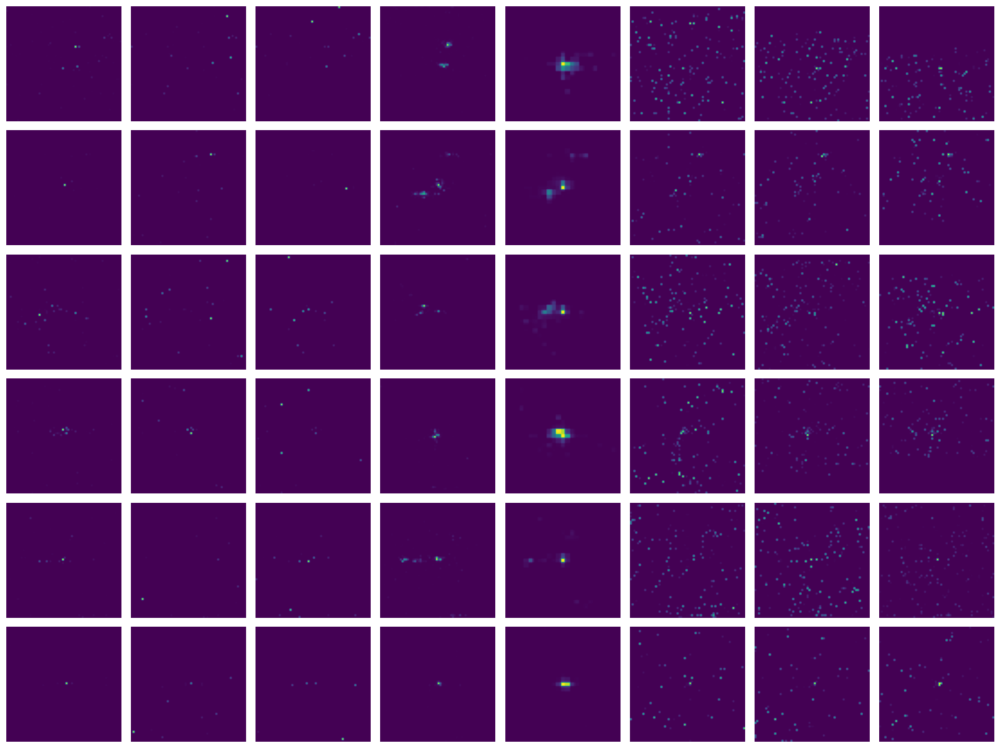

In [6]:
import matplotlib.pyplot as plt
import torch

def plot_batch_channels(dataloader):
    """
    Takes the first batch from the dataloader and plots each image's 8 channels.
    Each row corresponds to one sample (an 8-channel image), and each column shows one channel.
    """
    # Get first batch of images; assuming dataloader returns (images, labels)
    batch = next(iter(dataloader)).cpu()  # shape: (batch_size, channels, H, W)
    batch_size, channels, H, W = batch.shape
    batch_size=int(batch_size/10)
    if channels != 8:
        print(f"Warning: Expected 8 channels, but got {channels}.")
    
    # Create a grid with batch_size rows and 8 columns
    fig, axes = plt.subplots(batch_size, 8, figsize=(8*2, batch_size*2))  # adjust figsize as needed

    # If batch_size==1, axes might be 1D so we handle that:
    if batch_size == 1:
        axes = axes.reshape(1, -1)

    for i in range(batch_size):
        for j in range(8):
            ax = axes[i, j]
            # Plot channel j of sample i. We use a colorful colormap (e.g., viridis) for better visualization.
            ax.imshow(batch[i, j], cmap='viridis')
            ax.axis('off')
            if j == 0:
                ax.set_ylabel(f"Sample {i+1}", fontsize=12)
    
    plt.tight_layout()
    plt.show()

# Example usage:
plot_batch_channels(dataloader)


In [7]:
alphas_cumprod[-100::]

tensor([0.0162, 0.0161, 0.0159, 0.0158, 0.0157, 0.0155, 0.0154, 0.0152, 0.0151,
        0.0150, 0.0148, 0.0147, 0.0146, 0.0144, 0.0143, 0.0142, 0.0140, 0.0139,
        0.0138, 0.0136, 0.0135, 0.0134, 0.0133, 0.0131, 0.0130, 0.0129, 0.0128,
        0.0127, 0.0125, 0.0124, 0.0123, 0.0122, 0.0121, 0.0120, 0.0119, 0.0118,
        0.0116, 0.0115, 0.0114, 0.0113, 0.0112, 0.0111, 0.0110, 0.0109, 0.0108,
        0.0107, 0.0106, 0.0105, 0.0104, 0.0103, 0.0102, 0.0101, 0.0100, 0.0099,
        0.0098, 0.0097, 0.0096, 0.0095, 0.0094, 0.0093, 0.0093, 0.0092, 0.0091,
        0.0090, 0.0089, 0.0088, 0.0087, 0.0086, 0.0086, 0.0085, 0.0084, 0.0083,
        0.0082, 0.0082, 0.0081, 0.0080, 0.0079, 0.0078, 0.0078, 0.0077, 0.0076,
        0.0075, 0.0075, 0.0074, 0.0073, 0.0072, 0.0072, 0.0071, 0.0070, 0.0070,
        0.0069, 0.0068, 0.0068, 0.0067, 0.0066, 0.0066, 0.0065, 0.0064, 0.0064,
        0.0063])

In [8]:

@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. Applies noise if we are not at timestep 0.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x.shape)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    
    # Call model to predict noise (assumes model(x, t) is defined)
    model_mean = sqrt_recip_alphas_t * (x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t)
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)
    
    # Check if all elements of t are zero:
    if torch.all(t == 0):
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise 

@torch.no_grad()
def sample_diffusion_process(model, img_size=64, num_timesteps=25, device="cuda"):
    """
    Runs the reverse diffusion process on an 8-channel noise image.
    Returns a list of intermediate images (one per selected timestep).
    The images progress from denoised (left) to noise (right).
    """
    # Start with a noise image of shape (1, 8, img_size, img_size)
    x = torch.randn((1, 8, img_size, img_size), device=device)
    
    outputs = []
    # Calculate the step interval (T is total timesteps used in diffusion process)
    step = T // num_timesteps  if num_timesteps > 0 else 1
    
    # Loop from T-1 down to 0
    for i in range(T-1, -1, -1):
        t = torch.full((1,), i, device=device, dtype=torch.long)
        x = sample_timestep(x, t)
        x = torch.clamp(x, -1.0, 1.0)
        # Save image every "step" timesteps
        if i % step == 0:
            outputs.append(x.clone())
    
    # Reverse the outputs so that the leftmost is denoised (t=0) and rightmost is noise
    outputs = outputs[::-1]
    return outputs

@torch.no_grad()
def plot_diffusion_grid(outputs):
    """
    Plots the diffusion process in a grid:
      - 8 rows (one per channel)
      - Columns equal to the number of saved timesteps (e.g., 25)
    Uses a colormap (viridis) for better visualization.
    """
    num_cols = len(outputs)
    # Each output is of shape (1, 8, H, W); remove batch dimension.
    # Create an 8 x num_cols grid.
    fig, axes = plt.subplots(8, num_cols, figsize=(num_cols * 1.2, 8 * 1.2))
    
    for col, img in enumerate(outputs):
        img = img.squeeze(0).cpu()  # Now shape is (8, H, W)
        for channel in range(8):
            # Show the channel image with a colorful colormap instead of grayscale
            axes[channel, col].imshow(img[channel], cmap='viridis')
            axes[channel, col].axis('off')
    
    plt.suptitle("Diffusion Process: Left = Denoised (t=0), Right = Pure Noise", fontsize=16)
    plt.tight_layout()
    plt.show()

@torch.no_grad()
def sample_plot_image():
    """
    Runs the reverse diffusion process on an 8-channel image and plots the result:
    8 rows (channels) x 25 columns (timesteps).
    """
    outputs = sample_diffusion_process(model, img_size=IMG_SIZE, num_timesteps=25, device=device)
    plot_diffusion_grid(outputs)


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch [0/5]: 100%|██████████| 937/937 [06:42<00:00,  2.33it/s, loss=0.74]


0.00075


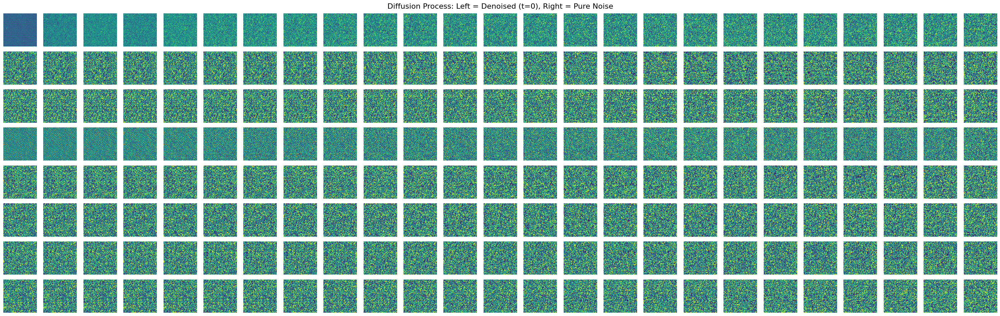

Epoch 0 | step 936 Loss: 0.6857372522354126 


Epoch [1/5]: 100%|██████████| 937/937 [06:41<00:00,  2.33it/s, loss=0.637]


0.0005625000000000001


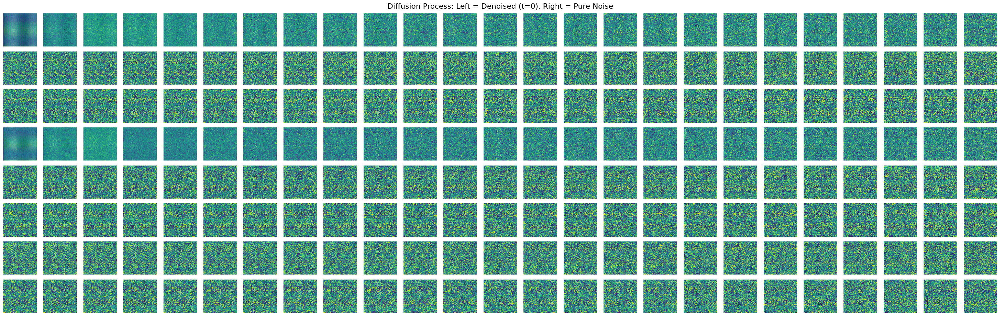

Epoch 1 | step 936 Loss: 0.6195321679115295 


Epoch [2/5]: 100%|██████████| 937/937 [06:41<00:00,  2.33it/s, loss=0.618]


0.00042187500000000005


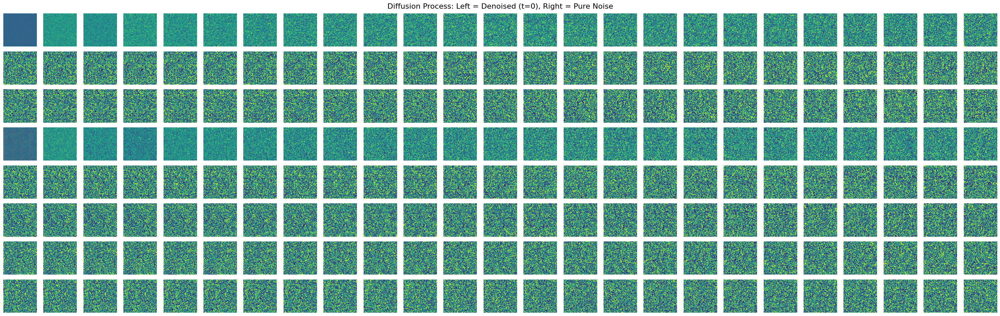

Epoch 2 | step 936 Loss: 0.6148943901062012 


Epoch [3/5]: 100%|██████████| 937/937 [06:41<00:00,  2.33it/s, loss=0.615]


0.00031640625000000006


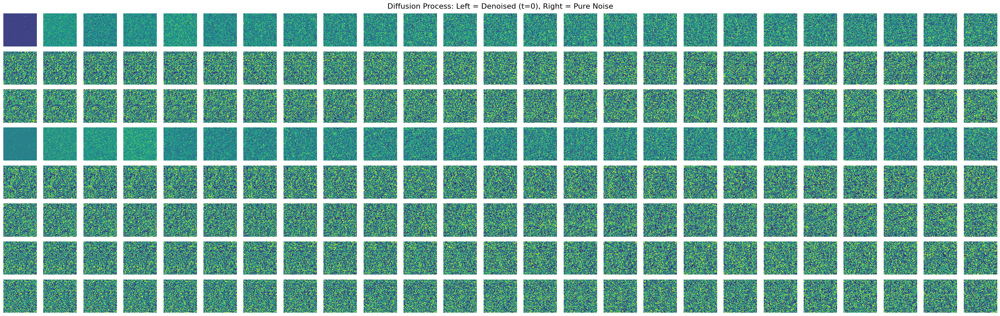

Epoch 3 | step 936 Loss: 0.6142518520355225 


Epoch [4/5]: 100%|██████████| 937/937 [06:41<00:00,  2.33it/s, loss=0.614]


0.00023730468750000005


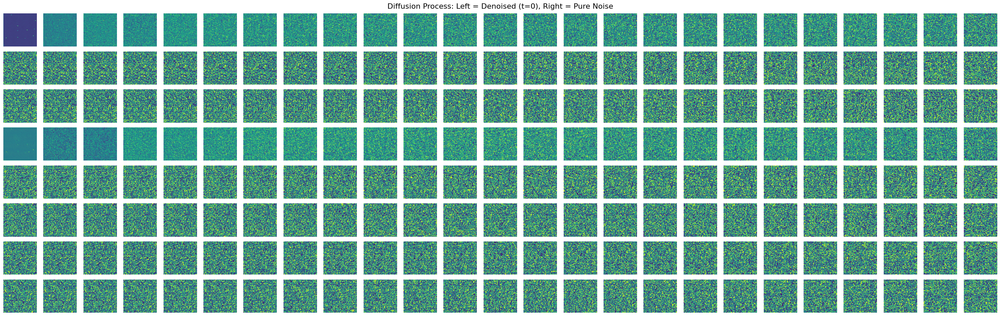

Epoch 4 | step 936 Loss: 0.6130164265632629 


In [9]:

model=unet(8,256)
IMG_SIZE=64
# BATCH_SIZE=32
import torch
from torch import optim
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)
epochs = 5 # Try more!

from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)
lplot=[]
from tqdm import tqdm
# for epoch in range(epochs+1):
for epoch in range(epochs):
    
    
    aloss = 0
    loop = tqdm(enumerate(dataloader), total=len(dataloader), desc=f"Epoch [{epoch}/{epochs}]")

    for step, batch in loop:
        optimizer.zero_grad()
        # print(batch[0].shape)
        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        
        x_noisy, noise = forward_diffusion_sample(batch, t, device)
        noise_pred = model(x_noisy.to(device), t)
        loss=F.l1_loss(noise.to(device), noise_pred)
        loss.backward()
        optimizer.step()
        aloss = (aloss * step + loss.item()) / (step + 1)
        loop.set_postfix(loss=aloss)
        lplot.append(aloss)
        # break
    lear=0
    for param_group in optimizer.param_groups:
        lear=param_group['lr']
    if lear>1e-4:
        for param_group in optimizer.param_groups:
            param_group['lr']*= 0.75 # Reduce LR by 1%
            print(param_group['lr'])
    else:
        for param_group in optimizer.param_groups:
            param_group['lr'] *= 0.99 # Reduce LR by 1%
            print(param_group['lr'])    
    # if epoch==15:
    #     for param_group in optimizer.param_groups:
    #         param_group['lr'] =1.3e-4 # Reduce LR by 1%
    #         print(param_group['lr'])
    sample_plot_image()

    print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
    scheduler.step(aloss) 
    # save_checkpoint(model,optimizer,10,10,"checkpoint6.pth")

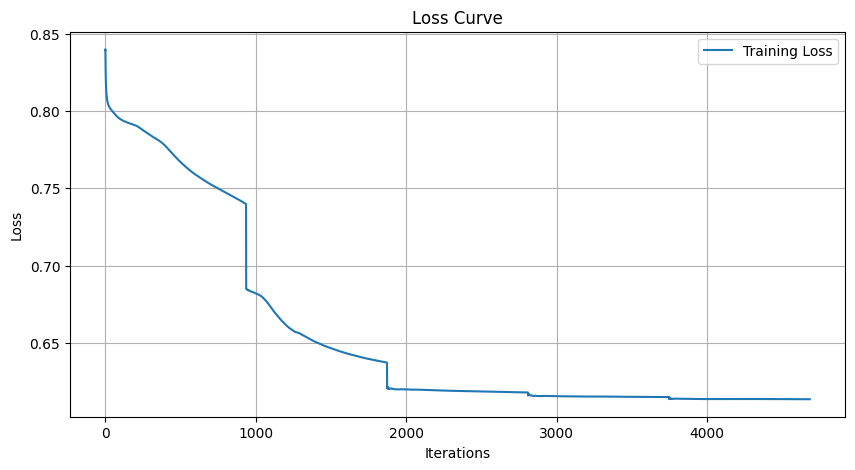

In [10]:
import matplotlib.pyplot as plt

def plot_losses(loss_list):
    plt.figure(figsize=(10, 5))
    plt.plot(loss_list, label='Training Loss')
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.title("Loss Curve")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_losses(lplot)


In [11]:
# # import shutil
# # shutil.move("/kaggle/working/Resized_Dataset_64x64.h5", "/kaggle/working/Resized_Dataset_64x64.h5")
# from IPython.display import FileLink, display
# display(FileLink("Resized_Dataset_64x64.h5"))
